In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mping
%matplotlib inline
import seaborn as sns
from pylab import *
from numpy import *
from numpy.random import *
from scipy.optimize import *
from sklearn.linear_model import LinearRegression
from pandas.plotting import scatter_matrix
import math

#map folium
import folium

#stats models
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.formula.api import ols

In [15]:
df=pd.read_csv('AB_NYC_2019.csv')

Project Question:  

Examining the Airbnb market in NYC for the average traveler

Which neighborhoods and room types have the most availability? 

How do different variables impact the price of listings in NYC for airbnb? 

Data Exploration

In [16]:
#show database information 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

Explore Unique Neighbourhood Groups

In [17]:
#look for unique neighbourhood groups
df.neighbourhood_group.unique()

array(['Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Bronx'],
      dtype=object)

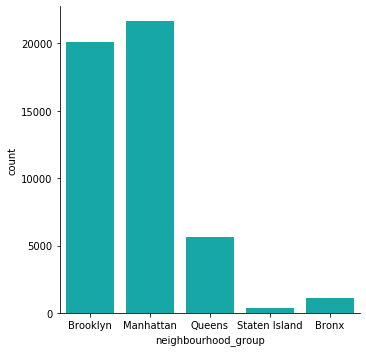

In [18]:
#count of listings in each neighbourhood group 
sns.catplot("neighbourhood_group", data=df, kind="count", height=5, color='c')

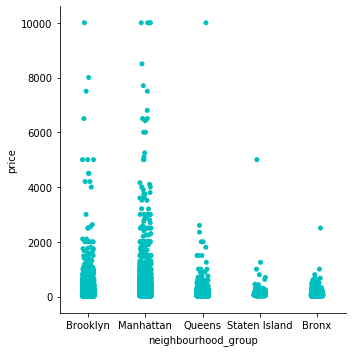

In [19]:
#price distribution for neighbourhood_group 
#notice some outliers for price by neighbourhood_group
sns.catplot(x ='neighbourhood_group', y = 'price', data=df, color='c')

Explore Unique Room Types

In [20]:
#look for unique room types 
df.room_type.unique()

array(['Private room', 'Entire home/apt', 'Shared room'], dtype=object)

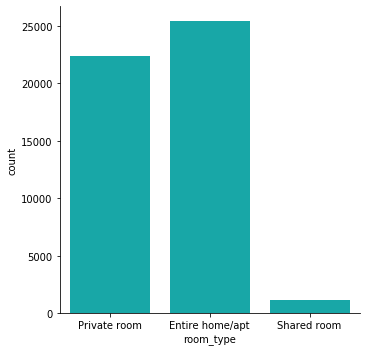

In [21]:
#count of listings per room type 
sns.catplot("room_type", data=df, kind="count", height=5, color='c')

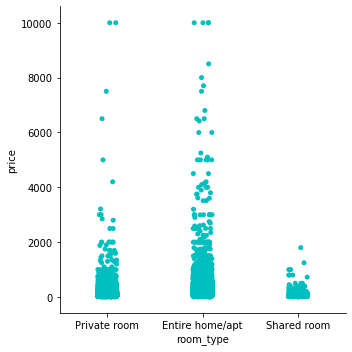

In [22]:
#price distribution for room types 
#notice some outliers for price by room type as well 
sns.catplot(x ='room_type', y = 'price', data=df, color='c')

Statistics of Price

In [23]:
#show statistics of price 
print(df['price'].describe())

count    48895.000000
mean       152.720687
std        240.154170
min          0.000000
25%         69.000000
50%        106.000000
75%        175.000000
max      10000.000000
Name: price, dtype: float64


Remove Outliers (removing top 2.5% and bottom 2.5%) to evaluate listings that a majority of travelers would search

In [24]:
#new database with outliers removed df2
#deciding to focus 
min_threshold = df['price'].quantile(0.025)
max_threshold = df['price'].quantile(0.975)
df2 = df[(df['price']<max_threshold) & (df['price']>min_threshold)]
print(df2['price'].max())
print(df2['price'].min())

499
36


In [25]:
#statistics of price with outliers removed
df2['price'].describe()

count    46216.000000
mean       133.165592
std         84.531330
min         36.000000
25%         70.000000
50%        108.000000
75%        175.000000
max        499.000000
Name: price, dtype: float64

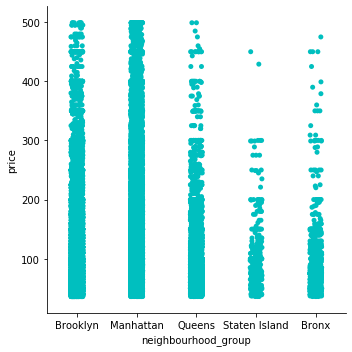

In [26]:
#price distribution for neighbourhood_group updated (outliers removed)
sns.catplot(x ='neighbourhood_group', y = 'price', data=df2, color='c')

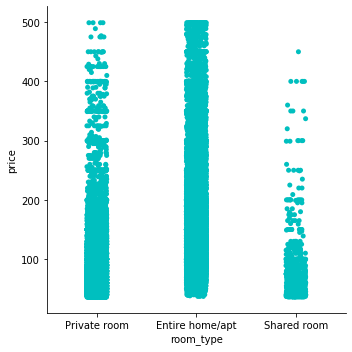

In [27]:
#price distribution for room types updated (outliers removed)
sns.catplot(x ='room_type', y = 'price', data=df2, color='c')

Evaluate Price Distributions for unique neighbourhoods (outliers removed)

In [28]:
#create database for each neighbourhood group
bro = df[df.neighbourhood_group == 'Brooklyn']
man = df[df.neighbourhood_group == 'Manhattan']
brx = df[df.neighbourhood_group == 'Bronx']
qne = df[df.neighbourhood_group == 'Queens']
sti = df[df.neighbourhood_group == 'Staten Island']

In [29]:
#create database for each neighbourhood group with outliers removed 
#outliers per neighbourhood, not overall 
bro2 = bro[(bro['price']<max_threshold) & (bro['price']>min_threshold)]
man2 = man[(man['price']<max_threshold) & (man['price']>min_threshold)]
qne2 = qne[(qne['price']<max_threshold) & (qne['price']>min_threshold)]
sti2 = sti[(sti['price']<max_threshold) & (sti['price']>min_threshold)]
brx2 = brx[(brx['price']<max_threshold) & (brx['price']>min_threshold)]

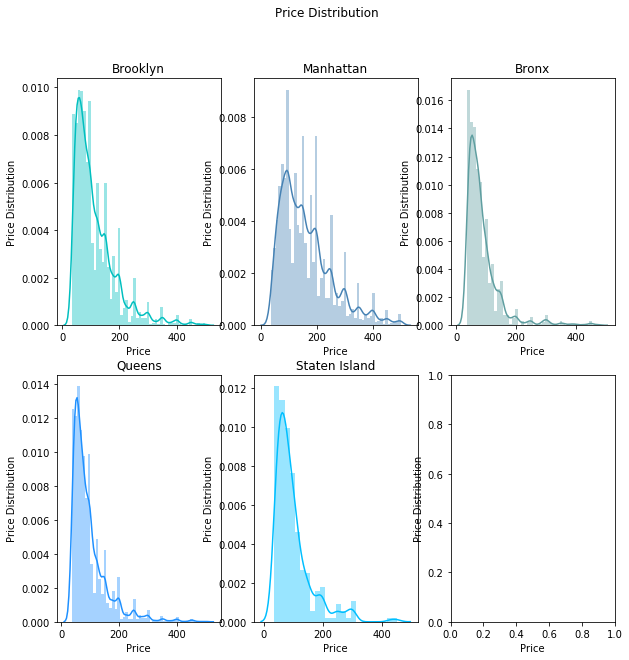

In [30]:
#show distributions of price without outliers 
f, axes = plt.subplots(2, 3, figsize=(10, 10), sharex=False)
f.suptitle('Price Distribution')
sns.distplot( bro2["price"] , color="c", ax=axes[0, 0])
sns.distplot( man2["price"] , color="steelblue", ax=axes[0, 1])
sns.distplot( qne2["price"] , color="dodgerblue", ax=axes[1, 0])
sns.distplot( sti2["price"] , color="deepskyblue", ax=axes[1, 1])
sns.distplot( brx2["price"] , color="cadetblue", ax=axes[0, 2])
axes[0, 0].set_title('Brooklyn')
axes[0, 1].set_title('Manhattan')
axes[1, 0].set_title('Queens')
axes[1, 1].set_title('Staten Island')
axes[0, 2].set_title('Bronx')
for axes in axes.flat:
    axes.set(xlabel='Price', ylabel='Price Distribution')

Evaluate Price Distributions for Unique Room Type (outliers removed)

In [31]:
#create database for each room type
apt = df[df.room_type == 'Entire home/apt']
proom = df[df.room_type == 'Private room']
sroom = df[df.room_type == 'Shared room']

In [32]:
#create database for each room type with outliers removed 
#outliers per room type, not overall 
apt2 = apt[(apt['price']<max_threshold) & (apt['price']>min_threshold)]
proom2 = proom[(proom['price']<max_threshold) & (proom['price']>min_threshold)]
sroom2 = sroom[(sroom['price']<max_threshold) & (sroom['price']>min_threshold)]

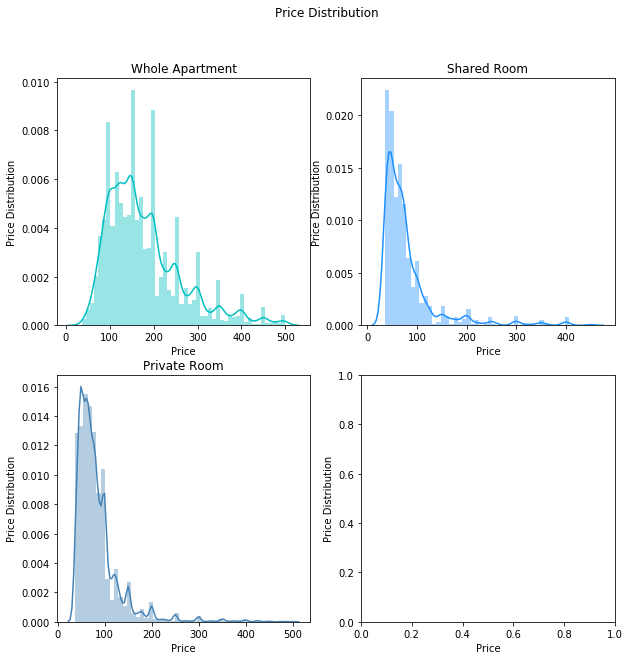

In [33]:
#show distributions of price without outliers 
f, axes = plt.subplots(2, 2, figsize=(10, 10), sharex=False)
f.suptitle('Price Distribution')

sns.distplot( apt2["price"] , color="c", ax=axes[0, 0])
sns.distplot( proom2["price"] , color="steelblue", ax=axes[1, 0])
sns.distplot( sroom2["price"] , color="dodgerblue", ax=axes[0, 1])
axes[0, 0].set_title('Whole Apartment')
axes[1, 0].set_title('Private Room')
axes[0, 1].set_title('Shared Room')
for axes in axes.flat:
    axes.set(xlabel='Price', ylabel='Price Distribution')

In [34]:
#statistics for neighbourhood groups
print('Brooklyn Price Statistics(outliers removed):')
print(bro2['price'].describe())

print('Manhattan Price Statistics(outliers removed):')
print(man2['price'].describe())

print('Queens Price Statistics(outliers removed):')
print(qne2['price'].describe())

print('Staten Island Price Statistics(outliers removed):')
print(sti2['price'].describe())

print('Bronx Price Statistics(outliers removed):')
print(brx2['price'].describe())

Brooklyn Price Statistics(outliers removed):
count    19073.000000
mean       114.853143
std         72.767792
min         36.000000
25%         63.000000
50%         95.000000
75%        150.000000
max        499.000000
Name: price, dtype: float64
Manhattan Price Statistics(outliers removed):
count    20572.000000
mean       162.276930
std         91.100912
min         36.000000
25%         95.000000
50%        145.000000
75%        200.000000
max        499.000000
Name: price, dtype: float64
Queens Price Statistics(outliers removed):
count    5280.000000
mean       96.420076
std        62.382037
min        36.000000
25%        55.000000
50%        75.000000
75%       115.000000
max       499.000000
Name: price, dtype: float64
Staten Island Price Statistics(outliers removed):
count    327.000000
mean      98.535168
std       62.937630
min       36.000000
25%       55.000000
50%       79.000000
75%      115.000000
max      450.000000
Name: price, dtype: float64
Bronx Price Statistics(o

In [35]:
#statistics for room types 
print('Whole Apt Price Statistics (outliers removed):')
print(apt2['price'].describe())

print('Single Room Price Statistics (outliers removed):')
print(sroom2['price'].describe())

print('Private Room Price Statistics (outliers removed):')
print(proom2['price'].describe())

Whole Apt Price Statistics (outliers removed):
count    24324.000000
mean       177.891013
std         84.836181
min         37.000000
25%        119.000000
50%        155.000000
75%        220.000000
max        499.000000
Name: price, dtype: float64
Single Room Price Statistics (outliers removed):
count    760.000000
mean      79.607895
std       57.973725
min       36.000000
25%       45.000000
50%       65.000000
75%       85.000000
max      450.000000
Name: price, dtype: float64
Private Room Price Statistics (outliers removed):
count    21132.000000
mean        83.610543
std         48.591310
min         36.000000
25%         55.000000
50%         70.000000
75%         98.000000
max        499.000000
Name: price, dtype: float64


Birds Eye View of Listings in NYC (outliers removed):

Regression on other variables:

In [77]:
#new database with outliers removed df4 (minimum_nights)
#deciding to focus 
min_threshold = df2['minimum_nights'].quantile(0.025)
max_threshold = df2['minimum_nights'].quantile(0.975)
df4 = df2[(df2['minimum_nights']<max_threshold) & (df2['minimum_nights']>min_threshold)]
print(df4['minimum_nights'].max())
print(df4['minimum_nights'].min())

29
2


In [78]:
#new database with outliers removed df5 (number_of_reviews)
#deciding to focus 
min_threshold = df4['number_of_reviews'].quantile(0.025)
max_threshold = df4['number_of_reviews'].quantile(0.975)
df5 = df4[(df4['number_of_reviews']<max_threshold) & (df4['number_of_reviews']>min_threshold)]
print(df5['number_of_reviews'].max())
print(df5['number_of_reviews'].min())

149
1


In [79]:
#new database with outliers removed df6 (reviews_per_month)
#deciding to focus 
min_threshold = df5['reviews_per_month'].quantile(0.025)
max_threshold = df5['reviews_per_month'].quantile(0.975)
df6 = df5[(df5['reviews_per_month']<max_threshold) & (df5['reviews_per_month']>min_threshold)]
print(df6['reviews_per_month'].max())
print(df6['reviews_per_month'].min())


4.47
0.04


In [80]:
#new database with outliers removed df7 (calculated_host_listings_count)
#deciding to focus 
min_threshold = df6['calculated_host_listings_count'].quantile(0.025)
max_threshold = df6['calculated_host_listings_count'].quantile(0.975)
df7 = df6[(df6['calculated_host_listings_count']<max_threshold) & (df6['calculated_host_listings_count']>min_threshold)]
print(df7['calculated_host_listings_count'].max())
print(df7['calculated_host_listings_count'].min())


7
2


In [81]:
#new database with outliers removed df8 (availability_365)
#deciding to focus 
min_threshold = df7['availability_365'].quantile(0.025)
max_threshold = df7['availability_365'].quantile(0.975)
df8 = df7[(df7['availability_365']<max_threshold) & (df7['availability_365']>min_threshold)]
print(df8['availability_365'].max())
print(df8['availability_365'].min())

363
1


In [82]:
#regression databases (Neighbourhood_group using df8)
df8bro = df8[df8.neighbourhood_group == 'Brooklyn']
df8man = df8[df8.neighbourhood_group == 'Manhattan']
df8brx = df8[df8.neighbourhood_group == 'Bronx']
df8qne = df8[df8.neighbourhood_group == 'Queens']
df8sti = df8[df8.neighbourhood_group == 'Staten Island']

In [83]:
#create database for each neighbourhood group with outliers removed 
#outliers per neighbourhood, not overall 
bro8 = df8bro[(df8bro['price']<max_threshold) & (df8bro['price']>min_threshold)]
man8 = df8man[(df8man['price']<max_threshold) & (df8man['price']>min_threshold)]
qne8 = df8qne[(df8qne['price']<max_threshold) & (df8qne['price']>min_threshold)]
sti8 = df8sti[(df8sti['price']<max_threshold) & (df8sti['price']>min_threshold)]
brx8 = df8brx[(df8brx['price']<max_threshold) & (df8brx['price']>min_threshold)]

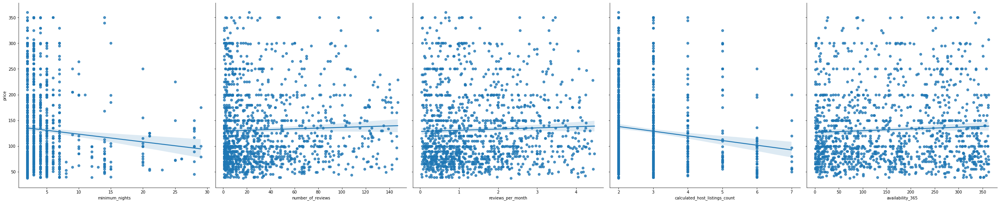

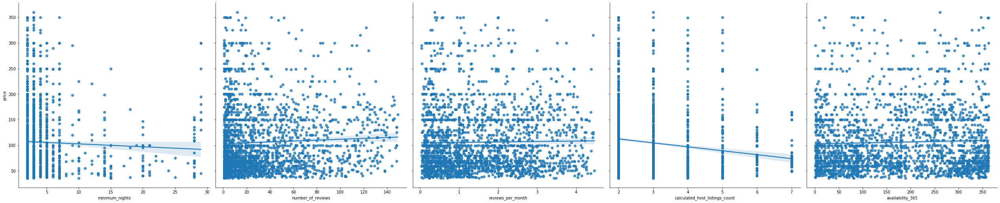

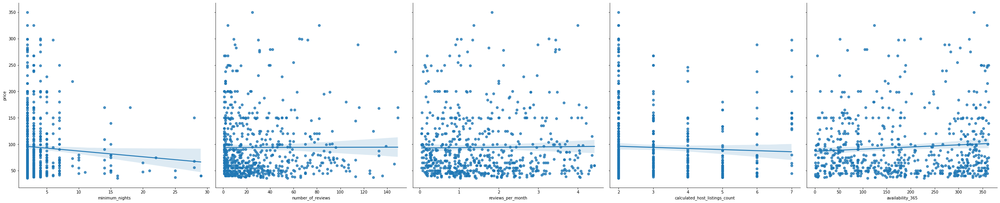

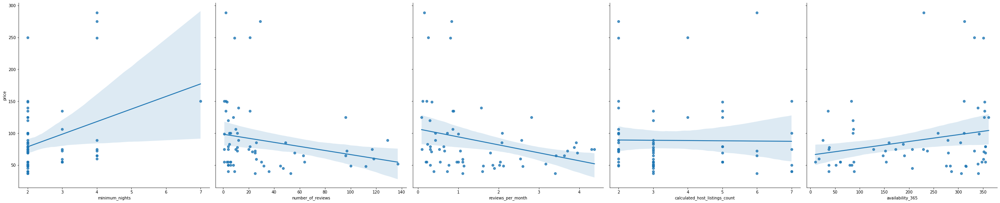

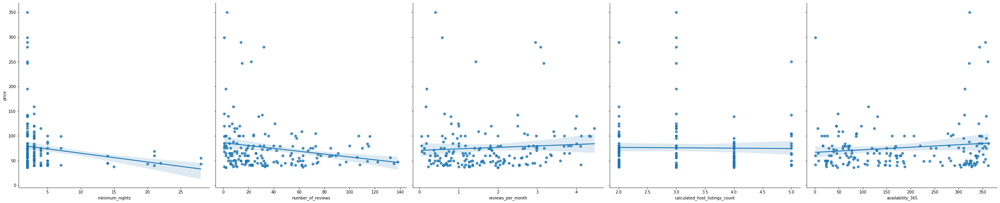

In [84]:
#regression neighbourhood types and room types vs int64 values (minimum nights, number of reviews, reviews per month, calculated host listing & avail 365) using df2
sns.pairplot(man8, x_vars=['minimum_nights','number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365'], y_vars='price', height=7, aspect = 1, kind='reg')
sns.pairplot(bro8, x_vars=['minimum_nights','number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365'], y_vars='price', height=7, aspect = 1, kind='reg')
sns.pairplot(qne8, x_vars=['minimum_nights','number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365'], y_vars='price', height=7, aspect = 1, kind='reg')
sns.pairplot(sti8, x_vars=['minimum_nights','number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365'], y_vars='price', height=7, aspect = 1, kind='reg')
sns.pairplot(brx8, x_vars=['minimum_nights','number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365'], y_vars='price', height=7, aspect = 1, kind='reg')


In [85]:
#regression databases (Room type using df8)
df8proom = df8[df8.room_type == 'Private room']
df8sroom = df8[df8.room_type == "Shared room"]
df8apt = df8[df8.room_type == "Entire home/apt"]

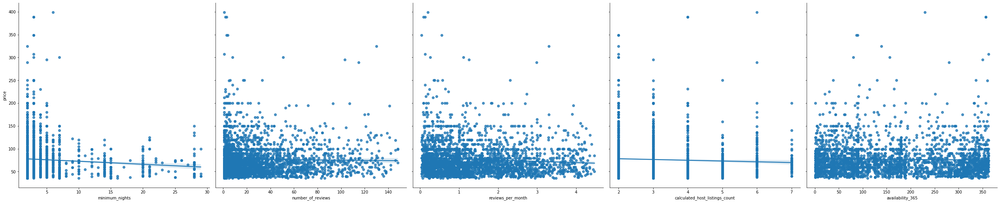

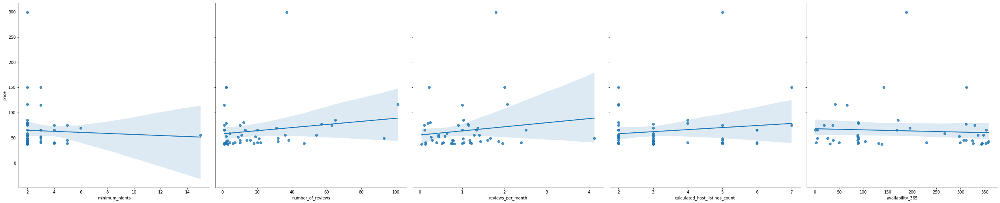

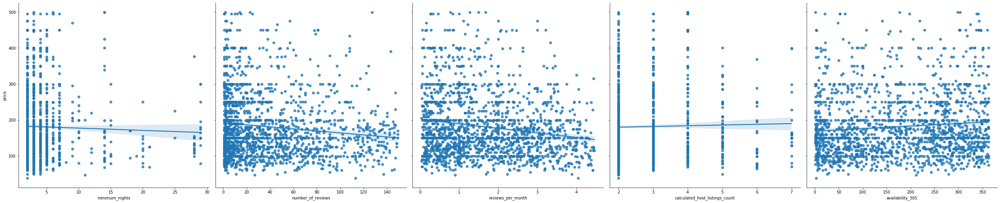

In [91]:
sns.pairplot(df8proom, x_vars=['minimum_nights','number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365'], y_vars='price', height=7, aspect = 1, kind='reg')
sns.pairplot(df8sroom, x_vars=['minimum_nights','number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365'], y_vars='price', height=7, aspect = 1, kind='reg')
sns.pairplot(df8apt, x_vars=['minimum_nights','number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365'], y_vars='price', height=7, aspect = 1, kind='reg')

In [71]:
m2 = folium.Map(location=[40.75362, -73.98377], zoom_start=10, max_zoom=12, min_zoom=8)

for i in range(0,len(df2)):
   folium.Circle(
      location=[df2.iloc[i]['latitude'], df2.iloc[i]['longitude']],
      color='blue',
      radius=10,
      fill=True,
      fill_color='blue'
   ).add_to(m2)

m2

Which Neighborhood has the Greatest Market Share?

Greatest Market Share by Neighbourhood Group

In [37]:
bro3 = bro2['price'].sum()
man3 = man2['price'].sum()
qne3 = qne2['price'].sum()
sti3 = sti2['price'].sum()
brx3 = brx2['price'].sum()

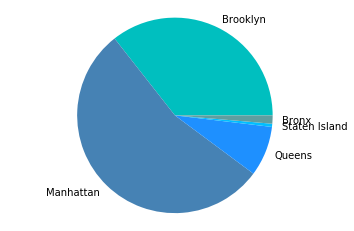

In [38]:
#sum(price) of all listings by neighbourhood using df2
labels = 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Bronx'
prices = [bro3, man3, qne3, sti3, brx3]
colors = ['c','steelblue','dodgerblue', 'deepskyblue', 'cadetblue']
plt.pie(prices, labels=labels, colors=colors)
plt.axis('equal')
plt.show()

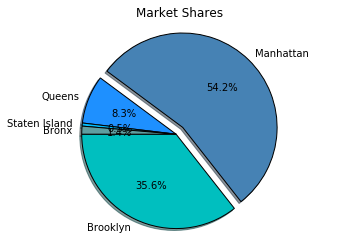

In [39]:
#market share of listings by neighbourhood 
labels = 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Bronx'
prices = [bro3, man3, qne3, sti3, brx3]
colors = ['c','steelblue','dodgerblue', 'deepskyblue', 'cadetblue']
explode = [0,0.1,0,0,0]
plt.pie(prices, labels=labels, colors=colors, explode=explode, 
        shadow=True, startangle=180, autopct='%1.1f%%',
       wedgeprops={'edgecolor':'black'})
plt.axis('equal')
plt.title("Market Shares")
plt.show()

Greatest Market Share by Room Type

In [40]:
apt3 = apt2['price'].sum()
sroom3 = sroom2['price'].sum()
proom3 = proom2['price'].sum()

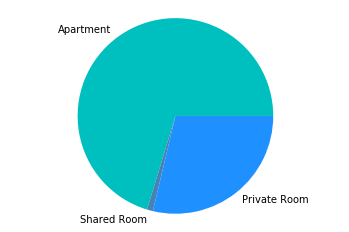

In [41]:
#sum(price) of all listings by room types using df2 
labels = 'Apartment', 'Shared Room', 'Private Room'
prices = [apt3, sroom3, proom3]
colors = ['c','steelblue','dodgerblue']
plt.pie(prices, labels=labels, colors=colors)
plt.axis('equal')
plt.show()

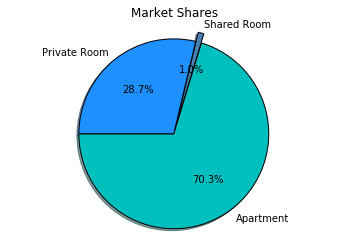

In [42]:
#market share of listings by neighbourhood 
labels = 'Apartment', 'Shared Room', 'Private Room'
prices = [apt3, sroom3, proom3]
colors = ['c','steelblue','dodgerblue']
explode = [0,0.1,0]
plt.pie(prices, labels=labels, colors=colors, explode=explode, 
        shadow=True, startangle=180, autopct='%1.1f%%',
       wedgeprops={'edgecolor':'black'})
plt.axis('equal')
plt.title("Market Shares")
plt.show()

Regression on Variables: Neighborhood Group and Room Type

Creating a new database with numbers in place of strings

In [43]:
df3 = df2.replace(to_replace=['Shared room', 'Private room', 'Entire home/apt'], value=[1, 2, 3]) 
df3 = df3.replace(to_replace=['Staten Island', 'Bronx', 'Queens', 'Brooklyn', 'Manhattan'], value=[4, 5, 6, 7, 8])

In [44]:
df3.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,7,Kensington,40.64749,-73.97237,2,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,8,Midtown,40.75362,-73.98377,3,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,8,Harlem,40.80902,-73.94190,2,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,7,Clinton Hill,40.68514,-73.95976,3,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,8,East Harlem,40.79851,-73.94399,3,80,10,9,2018-11-19,0.10,1,0


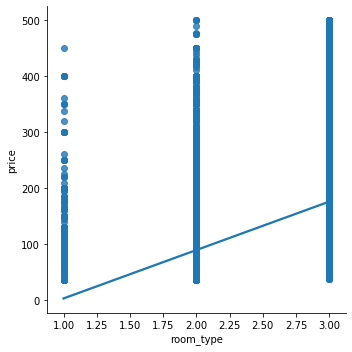

In [45]:
#regression for room type and price - rooms ordered from least listings to most listings 
#1 - shared room, #2 - private room, #3 - entire apartment 
sns.lmplot(x="room_type", y="price", data=df3)

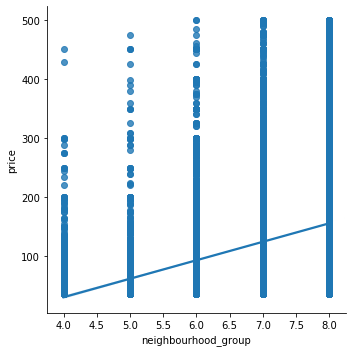

In [46]:
#regression for neighborhood and price - neighborhoods ordered from least listings to most listings
#4 - Staten Island, #5 - Bronx', #6 - Queens, #7 - Brooklyn, #8 - Manhattan
sns.lmplot(x="neighbourhood_group", y="price", data=df3)

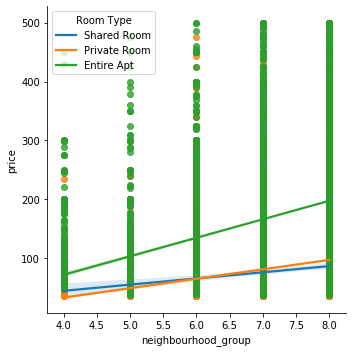

In [90]:
#1 - shared room, #2 - private room, #3 - entire apartment
#4 - Staten Island, #5 - Bronx', #6 - Queens, #7 - Brooklyn, #8 - Manhattan
g = sns.lmplot(x="neighbourhood_group", y="price", hue="room_type", data=df3, legend=False);

# replace labels in key
plt.legend(title='Room Type', loc='upper left', labels=['Shared Room', 'Private Room', 'Entire Apt'])
plt.show(g)

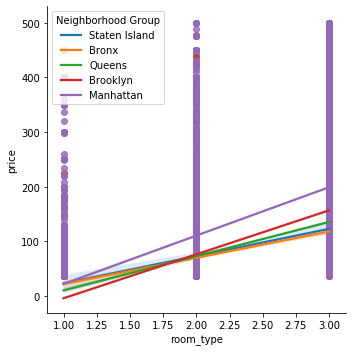

In [69]:
#1 - shared room, #2 - private room, #3 - entire apartment 
h=sns.lmplot(x="room_type", y="price", hue="neighbourhood_group", data=df3, legend=False);

# replace labels in key
plt.legend(title='Neighborhood Group', loc='upper left', labels=['Staten Island', 'Bronx', 'Queens', 'Brooklyn', 'Manhattan'])
plt.show(h)

Identifying significant relationships using stats models

In [49]:
#anova or f-test (Neighborhood Group on Price) Bronx is the Intercept
NG_onPrice = ols("price ~ neighbourhood_group", df2).fit()
print(NG_onPrice.summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.101
Model:                            OLS   Adj. R-squared:                  0.101
Method:                 Least Squares   F-statistic:                     1299.
Date:                Mon, 03 Aug 2020   Prob (F-statistic):               0.00
Time:                        10:48:12   Log-Likelihood:            -2.6818e+05
No. Observations:               46216   AIC:                         5.364e+05
Df Residuals:                   46211   BIC:                         5.364e+05
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                                           coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------


In [50]:
#anova or f-test (Room Type on Price) Entire Apt is the Intercept
RT_onPrice = ols("price ~ room_type", df2).fit()
print(RT_onPrice.summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.311
Model:                            OLS   Adj. R-squared:                  0.311
Method:                 Least Squares   F-statistic:                 1.043e+04
Date:                Mon, 03 Aug 2020   Prob (F-statistic):               0.00
Time:                        10:48:20   Log-Likelihood:            -2.6203e+05
No. Observations:               46216   AIC:                         5.241e+05
Df Residuals:                   46213   BIC:                         5.241e+05
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
Intercept             

In [51]:
#anova or f-test (Room Type and Neighborhood Group on Price) Bronx and Entire Apartment is the Intercept
RT_and_NG_onPrice = ols("price ~ room_type * neighbourhood_group", df2).fit()
print(RT_and_NG_onPrice.summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.372
Model:                            OLS   Adj. R-squared:                  0.372
Method:                 Least Squares   F-statistic:                     1958.
Date:                Mon, 03 Aug 2020   Prob (F-statistic):               0.00
Time:                        10:48:25   Log-Likelihood:            -2.5988e+05
No. Observations:               46216   AIC:                         5.198e+05
Df Residuals:                   46201   BIC:                         5.199e+05
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                                                                     coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------